In [1]:
BUILD_DIR="build"
INPUT_FILE="tmp/sample.mp4"

IS_DEV_MODE=True
SAMPLER_FPS=0.25
SAMPLER_WIDTH=200
SAMPLER_HEIGHT=200

In [2]:
tmp_input_file="tmp/tmp_input_file.mp4"
tmp_skipped_file="tmp/skipped_video_sample.mp4"

In [7]:
import cv2

from IPython.display import display
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from deepface import DeepFace
import os

In [19]:
from libs import utils
from libs.utils import display_all_images

In [4]:
from libs.utils import save_to_pickle, load_from_pickle

pickles_loc='tmp/pickles'
def checkpoint_variable(var_name):
    print(f'saving/loading {var_name}')
    file_path = f'{pickles_loc}/{var_name}.pkl'
    var_value = None
    if var_name in globals():
        var_value = globals()[var_name];
        save_to_pickle(var_value, file_path)
    else :
        var_value = load_from_pickle(file_path)
        globals()[var_name] = var_value
    
    print(f'{var_name} saved/loaded')
    return var_value
    
def checkpoint():    
    os.makedirs(pickles_loc, exist_ok=True)
    checkpoint_variable('app_video_meta')
    checkpoint_variable('app_scenes')

checkpoint()

saving/loading app_video_meta
app_video_meta saved/loaded
saving/loading app_scenes
app_scenes saved/loaded


In [6]:
from libs.beans import AppVideoMeta
def get_video_meta(input_video_path):
    cap = cv2.VideoCapture(input_video_path)
    if not cap.isOpened():
        print("Error: Could not open video.")
        exit()
    meta = AppVideoMeta(
        cap.get(cv2.CAP_PROP_FRAME_WIDTH), 
        cap.get(cv2.CAP_PROP_FRAME_HEIGHT),
        cap.get(cv2.CAP_PROP_FRAME_COUNT)
    )
    cap.release()
    return meta
app_video_meta = get_video_meta(INPUT_FILE)

In [7]:
from libs.utils import is_file_recorded

def pre_filter_video(input_video_path, output_video_path, frame_std_threshold=50):
    
    # Open the video
    cap = cv2.VideoCapture(input_video_path)
    if not cap.isOpened():
        print("Error: Could not open video.")
        exit()
    # Define the codec and create VideoWriter object
    fourcc = cv2.VideoWriter_fourcc(*'avc1')  # or 'XVID'
    fps = cap.get(cv2.CAP_PROP_FPS)
    frame_count = cap.get(cv2.CAP_PROP_FRAME_COUNT)
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    out = cv2.VideoWriter(output_video_path, fourcc, fps, (frame_width, frame_height))
    pbar = tqdm(total=frame_count)
    skipped_frames = []
    ret, frame = cap.read()
    while ret:
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        std_dev = np.std(gray)
        if std_dev > frame_std_threshold:
            out.write(frame)
        else:
            skipped_frames.append(frame)
        ret, frame = cap.read()
        pbar.update(1)
        
    # Release everything when done
    cap.release()
    out.release()
    pbar.close()
    return skipped_frames

if not is_file_recorded(INPUT_FILE):
    skipped_frames = pre_filter_video(INPUT_FILE, tmp_input_file)

In [8]:
from libs.utils import record_file
from libs.utils import play_video
record_file(INPUT_FILE)
play_video(tmp_input_file, 'Video To Process')

In [9]:
def save_skipped_video(skipped_frames, output_video_path):
    if len(skipped_frames) == 0:
        return
    # Define the codec and create VideoWriter object
    fourcc = cv2.VideoWriter_fourcc(*'avc1') 
    height, width = skipped_frames[0].shape[:2]
    out = cv2.VideoWriter(output_video_path, fourcc, 30, (width, height))
    for frame in tqdm(skipped_frames, desc="Saving skipped video portion for analysis"):
        out.write(frame)
    out.release()
if not is_file_recorded(INPUT_FILE):
    save_skipped_video(skipped_frames, tmp_skipped_file)

In [10]:
from libs.utils import play_video
tmp_skipped_file="tmp/skipped_video_sample.mp4"
play_video(tmp_skipped_file, "Skipped Video Portion")

In [11]:
from scenedetect import open_video, SceneManager, ContentDetector
def detect_scenes(input_file, app_video_meta: AppVideoMeta):
    appbar = tqdm(total=app_video_meta.frame_count, desc='Detecting Scenes from Video')
    last_frame_pos = [0]
    def on_new_scene(frame: np.ndarray, frame_num: int):
        appbar.update(frame_num - last_frame_pos[0])
        last_frame_pos[0] = frame_num
    video = open_video(input_file)
    scene_manager = SceneManager()
    scene_manager.add_detector(ContentDetector())
    scene_manager.detect_scenes(video=video, callback=on_new_scene)
    appbar.update(app_video_meta.frame_count - last_frame_pos[0])
    appbar.close()
    return scene_manager.get_scene_list()
scene_list = detect_scenes(tmp_input_file, app_video_meta)

Detecting Scenes from Video:   0%|          | 0/4502.0 [00:00<?, ?it/s]

In [12]:
from libs.beans import AppScene, AppFrame
from libs.beans import AppVideoMeta

def read_scene_frames(scene_list, max_num_of_frames_per_scene, frame_std_threshold=10):
    cap = cv2.VideoCapture(INPUT_FILE)
    app_scenes = []
    skipped_frames = []
    cap.read()
    for scene in tqdm(scene_list, desc='Reading Frames from Scenes'):
        app_scene = AppScene()
        app_scene.scene_orig = scene
        scene_start_frame = scene[0].frame_num
        app_scene.frame_start = scene_start_frame
        scene_end_frame = scene[1].frame_num
        app_scene.frame_end = scene_end_frame
        incrementer = (scene_end_frame - scene_start_frame) / float(max_num_of_frames_per_scene)
        frame_idx = scene_start_frame + (incrementer / 2)
        counter = 0
        while frame_idx < scene_end_frame and counter < max_num_of_frames_per_scene:
            cap.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
            ret, frame = cap.read()
            app_frame = AppFrame(frame)
            if app_frame.frame_std_dev < frame_std_threshold:
                skipped_frames.append(app_frame)
                frame_idx = frame_idx - 1
                print('skipping frame')
                continue
            app_scene.frames.append(app_frame)
            counter = counter + 1
            frame_idx = frame_idx + incrementer
        app_scenes.append(app_scene)
    cap.release()
    return app_scenes

app_scenes = read_scene_frames(scene_list, max_num_of_frames_per_scene=15, frame_std_threshold=20)


Reading Frames from Scenes:   0%|          | 0/111 [00:00<?, ?it/s]

skipping frame


In [13]:
checkpoint()

saving app_video_meta
app_video_meta saved
saving app_scenes
app_scenes saved


python(8368) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
Processing images to display: 100%|███████████████████████████████████████████████████████████| 150/150 [00:01<00:00, 143.43it/s]


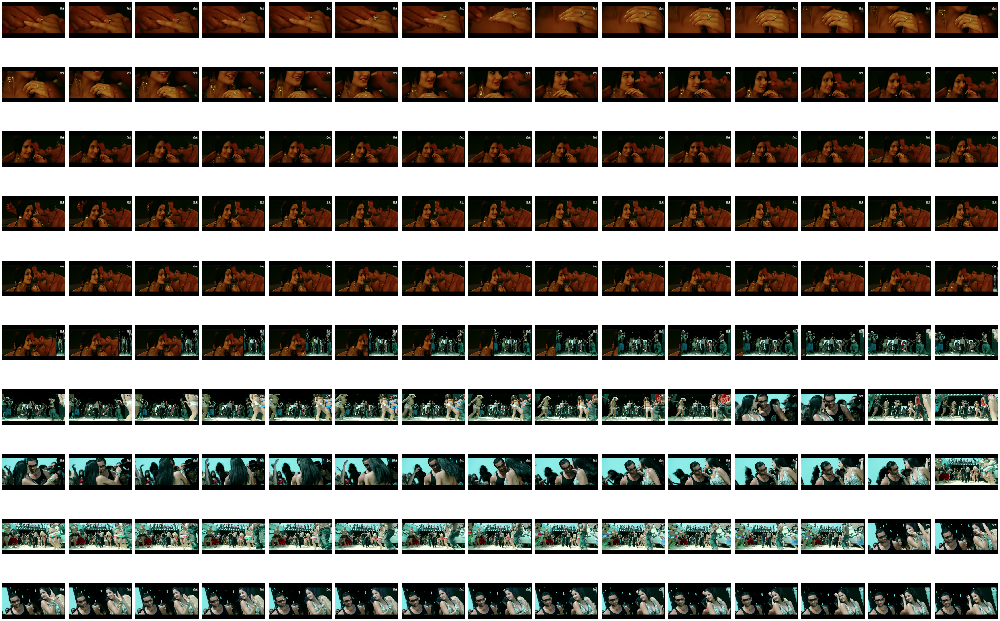

In [5]:
from libs import utils
from libs.utils import display_all_images

if IS_DEV_MODE:
    display_all_images(utils.flat_screen_frames(app_scenes[:10], lambda af:af.frame), 15)

In [15]:
from ultralytics import YOLO
model = YOLO('yolov8n.pt')
for i in tqdm(range(0, len(app_scenes)), desc='Detecting Objects from Frames'):
    scene = app_scenes[i]
    detects = model.track([ app_frame.frame for app_frame in scene.frames ], verbose=False)
    for i in range(len(detects)):
        app_frame = scene.frames[i]
        app_frame.detect = detects[i]


Detecting Objects from Frames:   0%|          | 0/111 [00:00<?, ?it/s]

Processing images to display: 100%|██████████████████████████████████████████████████████████████| 50/50 [00:01<00:00, 39.61it/s]


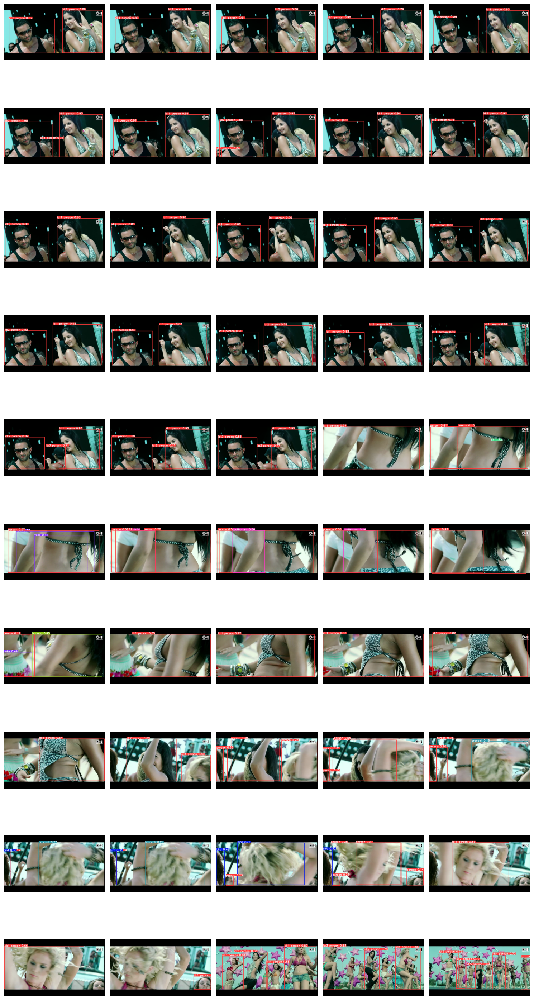

In [16]:
if IS_DEV_MODE:
    display_all_images(utils.flat_screen_frames(app_scenes[9:], lambda af:af.detect.plot())[:50], 5)

In [17]:
yolo_person_class = utils.find_key(model.names, 'person')
for detect in utils.flat_screen_frames(app_scenes, lambda af:af.detect):
    detected_boxes = []
    for box in detect.boxes: 
        if int(box.cls[0]) == yolo_person_class:
            detected_boxes.append(box)
    detect.boxes = detected_boxes

Processing images to display: 100%|██████████████████████████████████████████████████████████████| 50/50 [00:00<00:00, 75.63it/s]


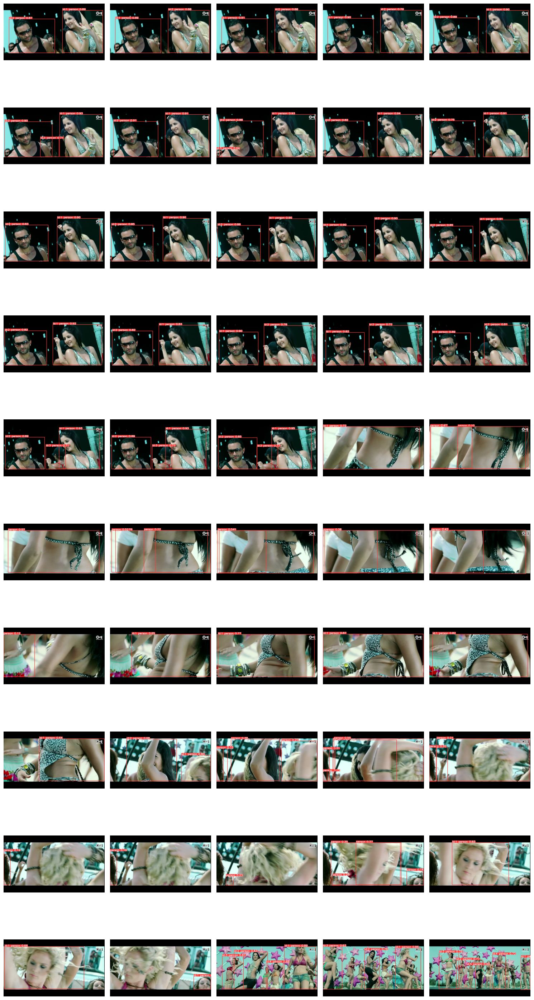

In [18]:
if IS_DEV_MODE:
    display_all_images(utils.flat_screen_frames(app_scenes[9:], lambda af:af.detect.plot())[:50])

In [24]:
checkpoint()

saving app_video_meta
app_video_meta saved
saving app_scenes
app_scenes saved


In [65]:
from libs import appfacers
from libs.utils import flat_screen_frames
import libs
import importlib
importlib.reload(libs.appfacers)

def detect_faces(app_scenes, app_facer, faces_width_threshold=0.1):
    app_facer.init()
    app_frames = flat_screen_frames(app_scenes, lambda af:af)
    for app_frame in tqdm(app_frames, desc='Detecting Faces in Frames'):
        faces = app_facer.detect_faces(app_frame.frame)
        app_frame.faces = faces

app_facer = appfacers.opencv
detect_faces(app_scenes, app_facer)

Detecting Faces in Frames:   0%|          | 0/1665 [00:00<?, ?it/s]

In [64]:

def show_faces(app_scenes, face_getter=lambda frame:frame.faces):
    frame_faces = []
    for app_frame in tqdm(utils.flat_screen_frames(app_scenes, lambda af:af), desc='Verifying Faces in Frames'):
        frame_copy = app_frame.detect.plot().copy()
        for face in face_getter(app_frame):
            x, y, w, h = app_facer.get_boundary(face)
            frame_copy = cv2.rectangle(frame_copy, (x, y), (x + w, y + h), (0, 255, 0), 2)
        frame_faces.append(frame_copy)
    display_all_images(frame_faces)
if IS_DEV_MODE:
    show_faces(app_scenes)

Verifying Faces in Frames:   0%|          | 0/1665 [00:00<?, ?it/s]

TypeError: 'NoneType' object is not iterable

In [63]:
from libs.beans import AppScene
def filter_faces(app_scenes: list[AppScene], face_size_threshold=0.1):
    def filter_face(face):
        face_width = app_facer.get_boundary(face)[2]
        face_frame_ratio = face_width / app_video_meta.width
        return face_frame_ratio >= face_size_threshold
    for app_scene in app_scenes:
        for app_frame in app_scene.frames:
            if app_frame is None or app_frame.faces is None:
                continue
            preface_len = len(app_frame.faces)
            app_frame.faces = [ face for face in app_frame.faces if filter_face(face) ]
                    
filter_faces(app_scenes)
show_faces(app_scenes, lambda frame:frame.faces)

Verifying Faces in Frames:   0%|          | 0/1665 [00:00<?, ?it/s]

TypeError: 'NoneType' object is not iterable

In [23]:
from dataclasses import dataclass, field
from libs.beans import AppScene, AppFrame
from ultralytics.engine.results import Boxes

@dataclass
class AppTrackedObjectBox:
    frame: AppFrame
    box: Boxes  # representing single box
    faces: list = field(default_factory=list)
    
@dataclass
class AppTrackedObject:
    obj_id: int = field(default=None)
    scene: AppScene = field(default=None)
    tracked_boxes: list[AppTrackedObjectBox] = field(default_factory=list)
    faces: list = field(default_factory=list)

In [24]:
def get_intersection_ratio(x11, y11, x12, y12, x21, y21, x22, y22):

    x_inter_left = max(x11, x21)
    y_inter_top = max(y11, y21)

    x_inter_right = min(x12, x22)
    y_inter_bottom = min(y12, y22)

    # print(x11, y11, x12, y12, x21, y21, x22, y22)
    if x_inter_right > x_inter_left and y_inter_bottom > y_inter_top:
        inter_width = x_inter_right - x_inter_left
        inter_height = y_inter_bottom - y_inter_top

        intersection_area = inter_width * inter_height
        object_area = (x22 - x21) * (y22 - y21)
        return intersection_area / float(object_area)
    else:
        return 0.0



In [25]:
app_scenes_object_to_boxes_mappings: list[dict[int, AppTrackedObject]] = []
for app_scene in app_scenes:
    object_id_boxes_dict = {}
    for app_frame in app_scene.frames:
        faces = app_frame.faces.copy() if app_frame.faces is not None else []
        
        # associate object_id to detect_boxes
        for box in app_frame.detect.boxes:
            if box.id is None:
                continue
                
            object_id = box.id.item()
            if not object_id in object_id_boxes_dict:
                object_id_boxes_dict[object_id] = AppTrackedObject(obj_id=object_id, scene=app_scene)
            
            tracked_object = object_id_boxes_dict[object_id]
            tracked_box = AppTrackedObjectBox(app_frame, box)
            tracked_object.tracked_boxes.append(tracked_box)
            
            x21, y21, x22, y22 = list(map(int, box.xyxy[0])) 
            # search face of the object (if any)
            for face in faces:
                x11, y11, w, h = app_facer.get_boundary(face)
                x12 = x11 + w
                y12 = y11 + h
                intersection_ratio = get_intersection_ratio(x11, y11, x12, y12, x21, y21, x22, y22)
                if intersection_ratio > 0.25:
                    tracked_box.faces.append(face)

        # associate object_id to faces
        # TODO: here
    
    app_scenes_object_to_boxes_mappings.append(object_id_boxes_dict)

Processing images to display: 100%|█████████████████████████████████████████████████████████████| 50/50 [00:00<00:00, 182.69it/s]


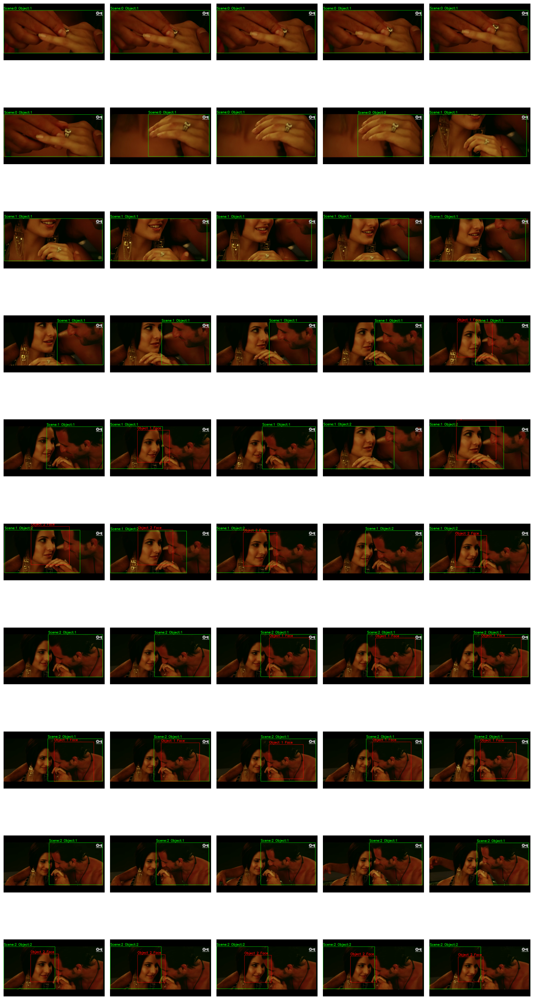

In [26]:
def cv2_put_text(image, text, position=(10, 10), color=(0, 255, 0)):
    font = cv2.FONT_HERSHEY_SIMPLEX  # Font type
    font_scale = 2  # Font scale (size)
    thickness = 5  # Thickness of the lines used to draw the text
    cv2.putText(image, text, position, font, font_scale, color, thickness)

def show_mappings(scenes_object_mappings: list[dict[int, AppTrackedObject]], app_scenes=app_scenes):
    images = []
    for object_boxes_dict in scenes_object_mappings:
        for tracked_object in object_boxes_dict.values():
            for tracked_box in tracked_object.tracked_boxes:
                x1, y1, x2, y2 = [ int(x) for x in tracked_box.box.xyxy[0].tolist()]
                image = np.copy(tracked_box.frame.frame)
                cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 3)
                cv2_put_text(image, f'Scene:{app_scenes.index(tracked_object.scene)} Object:{int(tracked_object.obj_id)}', (x1, y1 - 20))
                for face in tracked_box.faces:
                    x, y, w, h = app_facer.get_boundary(face)
                    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 0, 255), 3)
                    cv2_put_text(image, f'Object {int(tracked_object.obj_id)} Face', (x, y - 20), (0, 0, 255))
                images.append(image)
    display_all_images(images[:50])

show_mappings(app_scenes_object_to_boxes_mappings[:3])

faces filtered : 2/9/27


Processing images to display: 100%|███████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 943.62it/s]


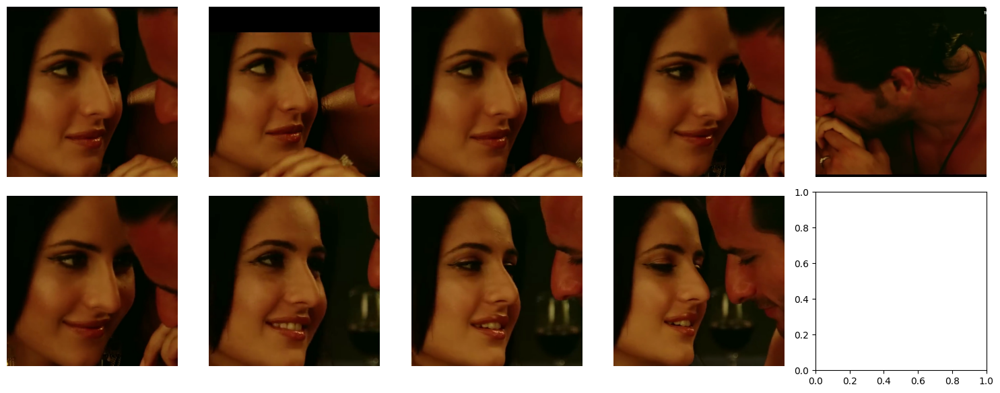

In [62]:
def resize_to_common(image1, image2):
    # Set a common size based on the smaller of the two images
    common_size = (min(image1.shape[1], image2.shape[1]), 
                   min(image1.shape[0], image2.shape[0]))

    # Resize both images
    resized_image1 = cv2.resize(image1, common_size, interpolation=cv2.INTER_AREA)
    resized_image2 = cv2.resize(image2, common_size, interpolation=cv2.INTER_AREA)
    
    return resized_image1, resized_image2


def mse(imageA, imageB):
    err = np.sum((imageA.astype("float") - imageB.astype("float")) ** 2)
    err /= float(imageA.shape[0] * imageA.shape[1])
    return err

    

@dataclass
class AppFrameSelectionHelper:
    prev_selected_frame = None
    prev_selected_face = None
    px, py, pw, ph = 0, 0, 0, 0

    images = []

    def get_frame_face(self):
        return self.prev_selected_frame[self.py:self.py+self.ph, self.px:self.px+self.pw]
    
    def is_prev_selected(self):
        return not self.prev_selected_frame is None
    
    def change_prev_selected(self, frame, face, x, y, w, h):
        self.prev_selected_frame = frame
        self.prev_selected_face = face
        self.px, self.py, self.pw, self.ph = x, y, w, h

    def commit_prev_selection(self):
        self.images.append(self.prev_selected_frame[self.py:self.py+self.ph, self.px:self.px+self.pw])

    def reset_selection(self):
        self.prev_selected_frame = None
    
def filter_out_same_faces(scenes_object_mappings: list[dict[int, AppTrackedObject]], threshold=0.01):
    max_mse = 255**2
    selector = AppFrameSelectionHelper()
    total_faces_counter = 0
    filtered_faces_counter = 0
    for object_boxes_dict in scenes_object_mappings:
        for tracked_object in object_boxes_dict.values():
            if len(tracked_object.tracked_boxes) > 1:
                selector.reset_selection()
                for tracked_box in tracked_object.tracked_boxes[1:]:
                    curr_frame = tracked_box.frame.frame
                    for curr_face in tracked_box.faces:
                        total_faces_counter += 1
                        x, y, w, h = app_facer.get_boundary(curr_face)
                        if not selector.is_prev_selected():
                            selector.change_prev_selected(curr_frame, curr_face, x, y, w, h)
                        else:
                            gray1 = cv2.cvtColor(curr_frame[y:y+h, x:x+w], cv2.COLOR_BGR2GRAY)
                            gray2 = cv2.cvtColor(selector.get_frame_face(), cv2.COLOR_BGR2GRAY)
                            gray1, gray2 = resize_to_common(gray1, gray2)
                            difference = mse(gray1, gray2) / max_mse
                            if difference > threshold:
                                filtered_faces_counter += 1
                                selector.commit_prev_selection()
                                selector.change_prev_selected(curr_frame, curr_face, x, y, w, h)
                            else:
                                if selector.pw < w:
                                    selector.change_prev_selected(curr_frame, curr_face, x, y, w, h)
                if selector.is_prev_selected():
                     selector.commit_prev_selection()
    print(f'faces filtered : {filtered_faces_counter}/{len(selector.images)}/{total_faces_counter}')
    display_all_images(selector.images)

filter_out_same_faces(app_scenes_object_to_boxes_mappings)

In [ ]:
def get_cropped_faces(app_scenes):
    frame_faces = []
    for app_frame in tqdm(utils.flat_screen_frames(app_scenes, lambda af:af), desc='Cropping Faces from Frames'):
        frame = app_frame.frame
        for face in app_frame.faces:
            x, y, w, h = app_facer.get_boundary(face)
            frame_faces.append(frame[y:y+h, x:x+w])
    return frame_faces
frame_faces = get_cropped_faces(app_scenes)
if IS_DEV_MODE:
    display_all_images(frame_faces[:50])

In [56]:
def get_face_categories(frame_faces, frame_from=10):
    distance_threshold = 0.7
    face_categories = [[frame_faces[frame_from]]]
    for frame_face in tqdm(frame_faces[frame_from:frame_from+50], 'Recognizing Faces'):
        next_face_categories=face_categories.copy()
        is_found = False
        found_cat_arr = None
        for face_cats in face_categories:
            for face_cat in face_cats:
                verification = DeepFace.verify(frame_face, face_cat, enforce_detection=False)
                if verification['verified'] and verification['distance'] < distance_threshold:
                    is_found = True
                    found_cat_arr = face_cats
                    break
            if is_found: 
                break;    
        if is_found:
            found_cat_arr.append(frame_face)
        else:
            next_face_categories.append([frame_face])
        face_categories=next_face_categories
    return face_categories
face_categories = get_face_categories(frame_faces)

NameError: name 'frame_faces' is not defined

Processing images to display: 100%|██████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 2809.17it/s]


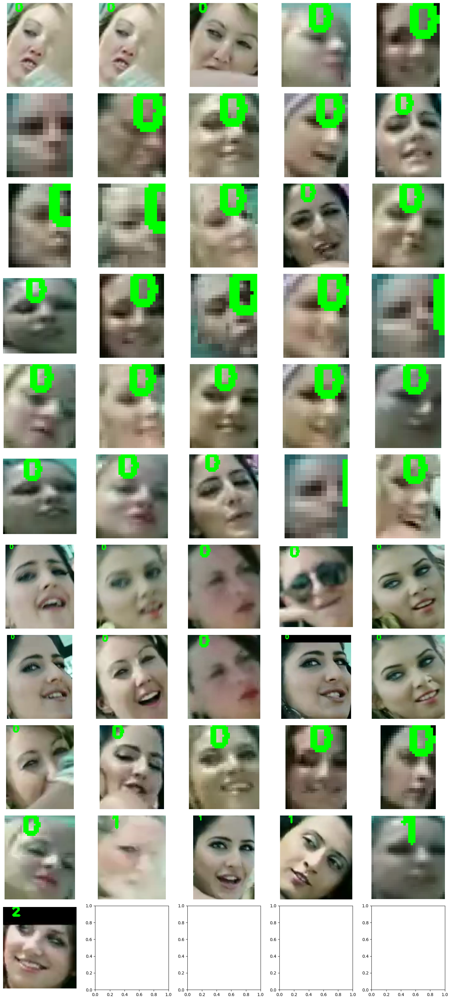

In [15]:
def get_face_display(face_categories):
    position = (10, 10)  # Bottom-left corner of the text in (x, y)
    font = cv2.FONT_HERSHEY_SIMPLEX  # Font type
    font_scale = 0.5  # Font scale (size)
    color = (0, 255, 0)  # Color in BGR (blue, green, red)
    thickness = 2  # Thickness of the lines used to draw the text
    face_display = []
    for face_category_index in range(0, len(face_categories)):
        face_category = face_categories[face_category_index]
        for face in face_category:
            face_copy = face.copy()
            cv2.putText(face_copy, str(face_category_index), position, font, font_scale, color, thickness)
            face_display.append(face_copy)
    return face_display
face_display = get_face_display(face_categories)
display_all_images(face_display)